In [1]:
import os
import glob
import pandas as pd
import numpy as np
import seaborn as sns
import string

from matplotlib.colors import LinearSegmentedColormap
from mpl_toolkits.axes_grid1 import make_axes_locatable
import matplotlib.pyplot as plt

from functions_jonne import createwells
from functions_jonne import plot_plates

pd.options.mode.chained_assignment = None  # default='warn'

os.chdir('./')

In [2]:
path = ('QC') 
if not os.path.exists(path):
    os.mkdir(path)
    print('folder created')
    
os.chdir('./QC')

# Remove images with low cell count or out of focus images

In [3]:
qc_folder = '/share/data/cellprofiler/automation/results/*P1035*'

f0 = sorted(glob.glob(qc_folder + '/*/*/qcRAW_image*')) 
f1_1 = [x for x in f0 if 'test' not in x]
f1_1 = [x for x in f1_1 if 'csv' not in x]

In [4]:
# list of QC files that should be included in analysis

platelist = f1_1
platelist = platelist[:23]
plates = [z.split('/')[6] for z in platelist] # check for each experiment!!!
plates


['P103554',
 'P103554',
 'P103555',
 'P103556',
 'P103557',
 'P103558',
 'P103559',
 'P103560',
 'P103561',
 'P103562',
 'P103563',
 'P103564',
 'P103565',
 'P103566',
 'P103567',
 'P103568',
 'P103569',
 'P103570',
 'P103571',
 'P103572',
 'P103573',
 'P103587',
 'P103588']

In [5]:
collected_df = []

for p in platelist:
    df = pd.read_parquet(p)
    cols = [col for col in df.columns if col.startswith(('Meta','ImageQuality','Count'))]
    collected_df.append(df[cols])


In [6]:
df = pd.concat(collected_df)
df = df.rename(columns={"Metadata_Barcode": "Metadata_plate_map_name"})
len(df)

76601

In [7]:
# Define your thresholds for QC

mincells = 20
maxcells = 1000
minpowerlog = -2.3
maxpercmax = 0.5

def set_flags(row):
    conditions = [
        (row["Count_nuclei"]                            < mincells, "flag_lowcellcount"),
        (row["Count_nuclei"]                            > maxcells, "flag_highcellcount"),
        
        (row["ImageQuality_PowerLogLogSlope_HOECHST"]   < -2.35, "flag_powerloglog_H"),
        (row["ImageQuality_PowerLogLogSlope_MITO"]      < -2.5, "flag_powerloglog_M"),
        (row["ImageQuality_PowerLogLogSlope_PHAandWGA"] < minpowerlog, "flag_powerloglog_P"),
        (row["ImageQuality_PowerLogLogSlope_CONC"]      < minpowerlog, "flag_powerloglog_C"),
        (row["ImageQuality_PowerLogLogSlope_SYTO"]      < minpowerlog, "flag_powerloglog_S"),
        
        (row["ImageQuality_PercentMaximal_HOECHST"]     > maxpercmax, "flag_percmax_H"),
        (row["ImageQuality_PercentMaximal_MITO"]        > maxpercmax, "flag_percmax_M"),
        (row["ImageQuality_PercentMaximal_PHAandWGA"]   > maxpercmax, "flag_percmax_P"),
        (row["ImageQuality_PercentMaximal_CONC"]        > maxpercmax, "flag_percmax_C"),
        (row["ImageQuality_PercentMaximal_SYTO"]        > maxpercmax, "flag_percmax_S")
    ]
    
    for condition, flag in conditions:
        if condition:
            return flag
    return "None"

df['flag'] = df.apply(set_flags, axis=1)

In [8]:
nrimages = len(df)
count = df[["flag", "Metadata_Site"]]
count = count.groupby("flag").count()
count["perc"] = (count["Metadata_Site"] / nrimages *100).round(2)
count

,Metadata_Site,perc
flag,,
None,74408,97.14
flag_highcellcount,1,0.00
flag_lowcellcount,1142,1.49
flag_percmax_C,30,0.04
flag_percmax_H,5,0.01
flag_percmax_P,6,0.01
flag_percmax_S,4,0.01
flag_powerloglog_C,61,0.08
flag_powerloglog_H,409,0.53


# filter out images

In [9]:
# Create a df for passed images
passed = df.loc[df["flag"] == "None"]
passed = passed[["Metadata_plate_map_name", "Metadata_Site", "Metadata_Well","ImageQuality_PercentMaximal_PHAandWGA"]]
passed = passed.drop_duplicates().reset_index(drop=True)
passed['ImageID'] = passed['Metadata_plate_map_name'] + "_" + passed['Metadata_Well'] + "_s" + passed['Metadata_Site'].astype(str).str.rstrip('.0')
passed.to_csv("level0_passed.csv")

In [10]:
# Create a df for flagged images
flagged = df.loc[df["flag"] != "None"]
flagged = flagged[["Metadata_plate_map_name", "Metadata_Site", "Metadata_Well","flag","ImageQuality_PercentMaximal_PHAandWGA"]]
flagged = flagged.drop_duplicates().reset_index(drop=True)
flagged['ImageID'] = flagged['Metadata_plate_map_name'] + "_" + flagged['Metadata_Well'] + "_s" + flagged['Metadata_Site'].astype(str).str.rstrip('.0')
flagged.to_csv("level0_flagged.csv")

In [11]:
# statistics
print("Passed images: ", len(passed), "out of", len(df), "which equals", len(passed)/len(df)*100, "%")
print("Flagged images: ", len(flagged), "out of", len(df), "which equals", len(flagged)/len(df)*100, "%")

Passed images:  73100 out of 76601 which equals 95.42956358272086 %
Flagged images:  2140 out of 76601 which equals 2.7936972102191877 %


# inspect plates

In [12]:
unique_plates = df['Metadata_plate_map_name'].unique()
all_wells = [f"{row}{col:02d}" for row in "ABCDEFGHIJKLMNOP" for col in range(1, 25)]
wells_in_plates = {}

for plate in unique_plates:
    wells_in_plate = df[df['Metadata_plate_map_name'] == plate]['Metadata_Well'].unique()
    missing_wells = set(all_wells) - set(wells_in_plate)
    wells_in_plates[plate] = {
        'total_wells': len(wells_in_plate),
        'missing_wells': missing_wells}

unique_plates

array(['P103554', 'P103555', 'P103556', 'P103557', 'P103558', 'P103559',
       'P103560', 'P103561', 'P103562', 'P103563', 'P103564', 'P103565',
       'P103566', 'P103567', 'P103568', 'P103569', 'P103570', 'P103571',
       'P103572', 'P103573', 'P103587', 'P103588'], dtype=object)

In [13]:
missing_df = pd.DataFrame.from_dict(wells_in_plates, orient='index').reset_index()
missing_df.columns = ['Plate_ID', 'Total_Wells', 'Missing_Wells']
missing_df['Missing_Wells'] = missing_df['Missing_Wells'].apply(lambda x: ', '.join(sorted(x)))
missing_df

,Plate_ID,Total_Wells,Missing_Wells
0,P103554,380,"A01, A24, P01, P24"
1,P103555,380,"A01, A24, P01, P24"
2,P103556,380,"A01, A24, P01, P24"
3,P103557,380,"A01, A24, P01, P24"
4,P103558,380,"A01, A24, P01, P24"
5,P103559,380,"A01, A24, P01, P24"
6,P103560,380,"A01, A24, P01, P24"
7,P103561,380,"A01, A24, P01, P24"
8,P103562,380,"A01, A24, P01, P24"
9,P103563,380,"A01, A24, P01, P24"


# plot heatmaps of features of choice

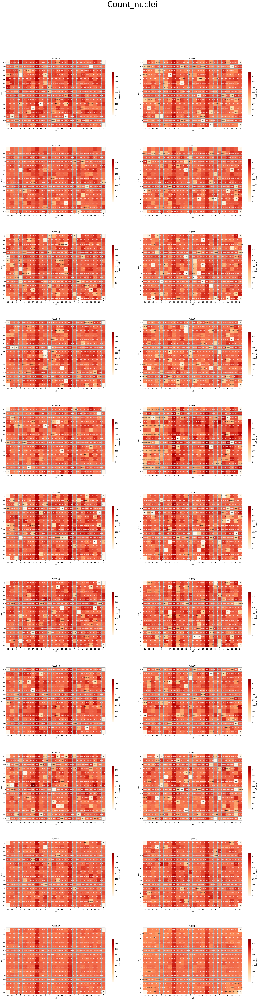

In [25]:
plot_plates(df, 'Count_nuclei')

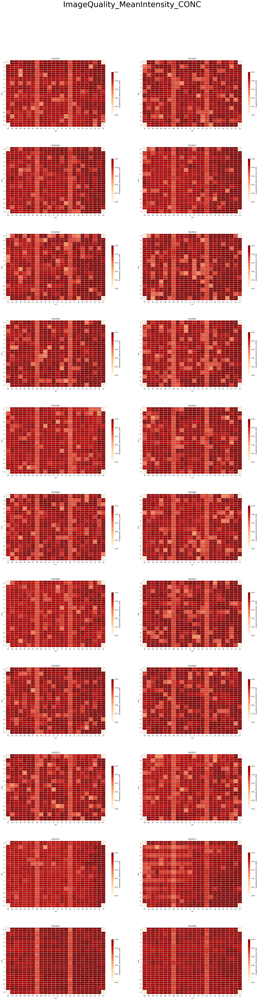

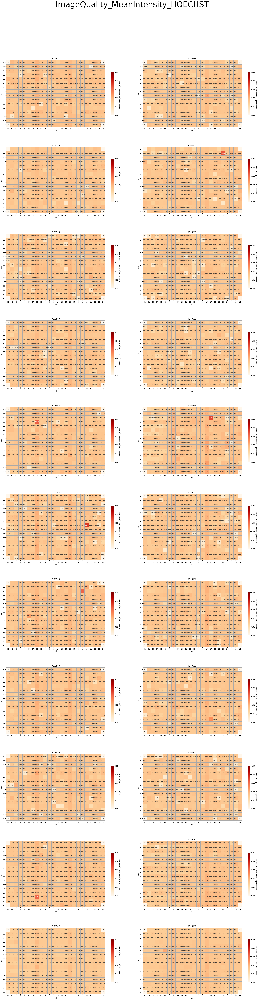

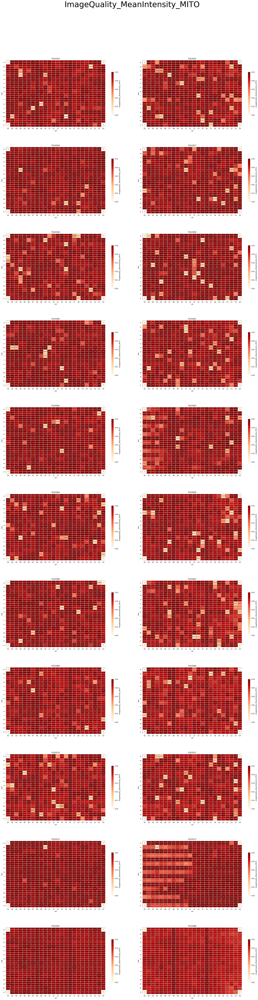

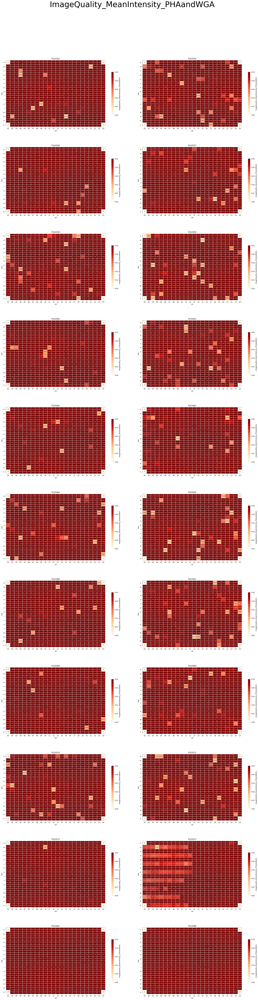

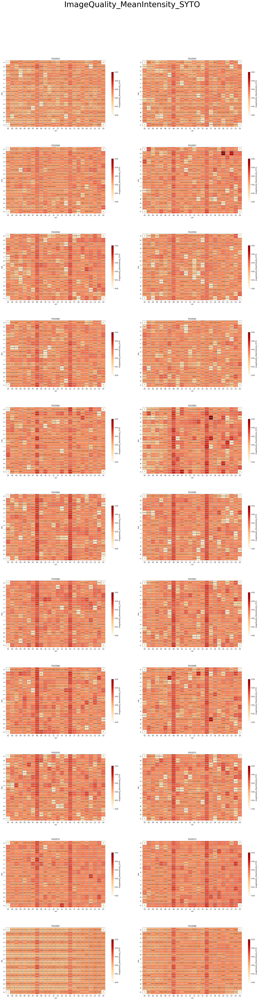

In [26]:
# intensity

selected_features = [col for col in values.columns if col.startswith('ImageQuality_MeanIntensity')]

for feature in selected_features:
    plot_plates(df, feature,vmax=0.05)

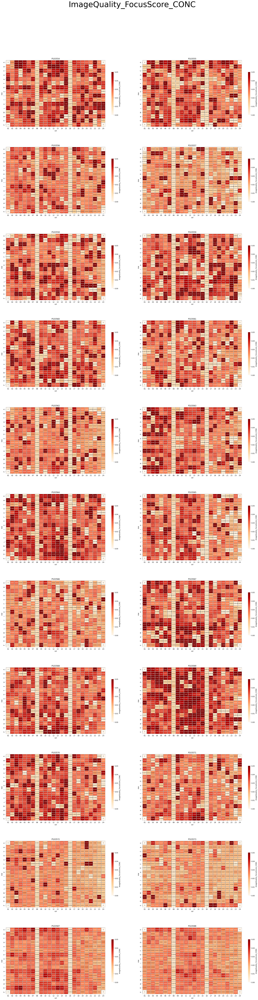

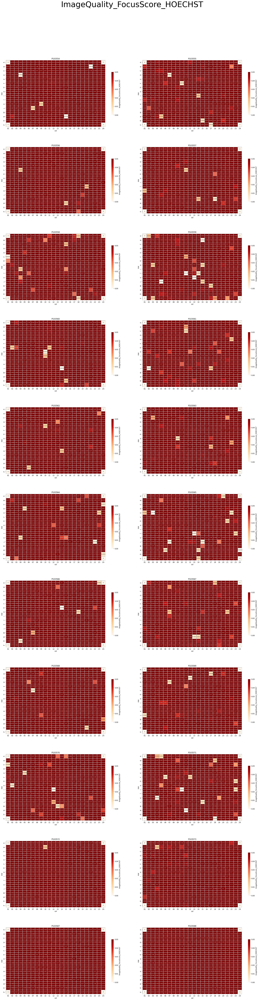

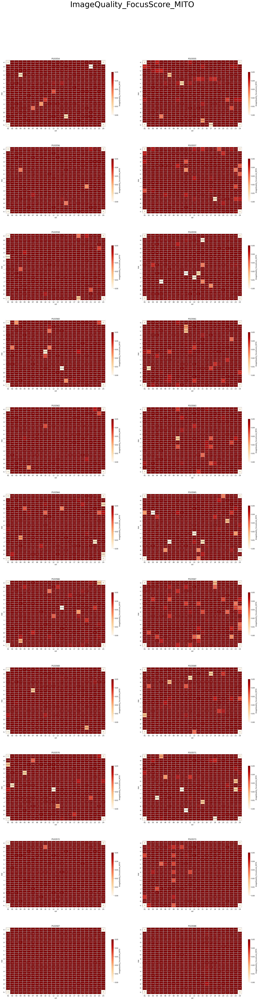

In [ ]:
# focusscore

selected_features = [col for col in values.columns if col.startswith('ImageQuality_FocusScore')]

for feature in selected_features:
    plot_plates(df, feature,vmax=0.05)